In [1]:
using Pkg
Pkg.activate("../../Project.toml")

include("../../LogLoss/RealRealHighDimension.jl")
include("../ForecastingMainNew.jl");
using JLD2
using DataFrames

  Activating project at `~/Documents/QML Project/QuantumInspiredML`


# ECG200

In [2]:
svpath = "../../Data/ecg200/mps_saves/legendreNN2_ns_d8_chi35.jld2"


f = jldopen(svpath, "r")
X_train_scaled = read(f, "X_train_scaled")
y_train = read(f, "y_train")
X_test_scaled = read(f, "X_test_scaled")
y_test = read(f, "y_test");
mps = read(f, "mps")
opts = read(f, "opts")
close(f)


setprecision(BigFloat, 128)
Rdtype = Float64

verbosity = 0
test_run = false
track_cost = false
#

project = false
encoding = legendre(norm=false, project=project)
encode_classes_separately = false
train_classes_separately = false

#encoding = Basis("Legendre")
dtype = encoding.iscomplex ? ComplexF64 : Float64

opts=Options(; nsweeps=20, chi_max=35,  update_iters=1, verbosity=verbosity, dtype=dtype, loss_grad=loss_grad_KLD,
bbopt=BBOpt("CustomGD"), track_cost=track_cost, eta=0.0025, rescale = (false, true), d=8, aux_basis_dim=2, encoding=encoding, 
encode_classes_separately=encode_classes_separately, train_classes_separately=train_classes_separately, exit_early=false, sigmoid_transform=false)

fc = load_forecasting_info_variables(mps, X_train_scaled, 
    y_train, X_test_scaled, y_test, opts);

++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
                         Summary:

 - Dataset has 100 training samples and 100 testing samples.
 - 2 class(es) was detected. Slicing MPS into individual states...
 - Time independent encoding - Legendre_No_Norm - detected.
 - d = 8, chi_max = 35

 Created 2 forecastable struct(s) containing class-wise mps and test samples.


╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │  0.426279 │
│    MSE │ 0.0249568 │
│   MAPE │  0.573732 │
│    MAE │   0.12176 │
│   RMSE │ 0.0249568 │
╰────────┴───────────╯
╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │  0.502432 │
│    MSE │ 0.0262031 │
│   MAPE │  0.752603 │
│    MAE │  0.141096 │
│   RMSE │ 0.0262031 │
╰────────┴───────────╯


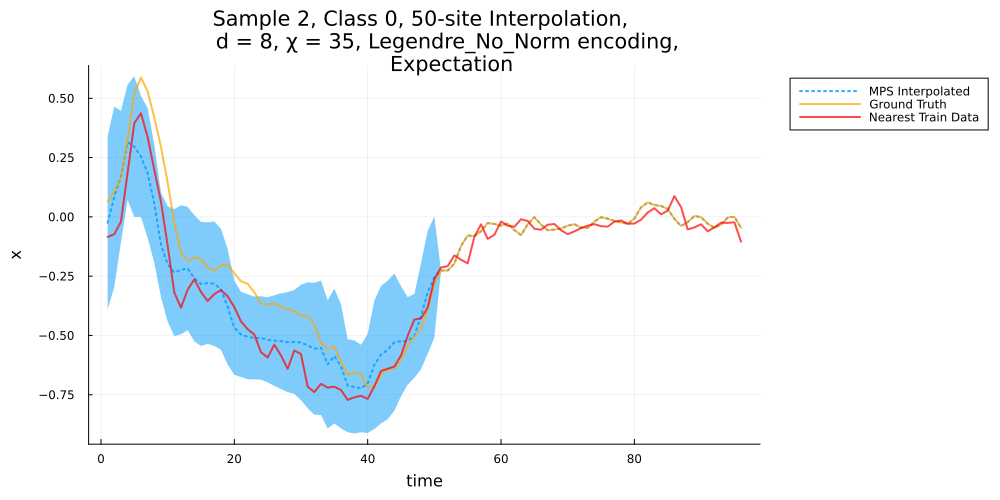

In [25]:


class = 0
interp_sites = collect(1:50)
instance_idx = 2
stats, mse_stats, p1 = any_interpolate_single_time_series(fc, class, instance_idx, interp_sites, :directMean; MSE_baseline=true, X_train_scaled=X_train_scaled, y_train=y_train, n_baselines=1);

plot(p1)

In [26]:
interp_sites = collect(2:50)

n1s = sum(y_test)
n0s = length(y_test) - n1s

n_each = 6


samples = [shuffle(1:n0s)[1:n_each]; shuffle(1:n1s)[1:n_each]]
classes = [zeros(Int,n_each); ones(Int,n_each)]

ps = []
stats = []
MSE_stats = []
for (i,s) in enumerate(samples)
    class = classes[i]
    instance_idx = s
    stat, MSE_stat, p1 = any_interpolate_single_time_series(fc, class, instance_idx, interp_sites, :directMean; MSE_baseline=true, X_train_scaled=X_train_scaled, y_train=y_train);
    push!(ps, p1)
    push!(stats, stat)
    push!(MSE_stats, MSE_stat)
end



╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │  0.778664 │
│    MSE │ 0.0238897 │
│   MAPE │   1.14965 │
│    MAE │  0.121886 │
│   RMSE │ 0.0238897 │
╰────────┴───────────╯
╭────────┬──────────╮
│ Metric │    Value │
├────────┼──────────┤
│  SMAPE │ 0.889308 │
│    MSE │ 0.119619 │
│   MAPE │  2.57594 │
│    MAE │ 0.242468 │
│   RMSE │ 0.119619 │
╰────────┴──────────╯
╭────────┬──────────╮
│ Metric │    Value │
├────────┼──────────┤
│  SMAPE │  1.14479 │
│    MSE │  0.13819 │
│   MAPE │   4.7116 │
│    MAE │ 0.320264 │
│   RMSE │  0.13819 │
╰────────┴──────────╯
╭────────┬──────────╮
│ Metric │    Value │
├────────┼──────────┤
│  SMAPE │ 0.876085 │
│    MSE │ 0.024972 │
│   MAPE │  1.97626 │
│    MAE │ 0.131191 │
│   RMSE │ 0.024972 │
╰────────┴──────────╯
╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │  0.404344 │
│    MSE │ 0.0234799 │
│   MAPE │  0.464128 │
│    MAE │  0.115713 │
│   RMSE │ 0.0234799 │
╰────────┴─────

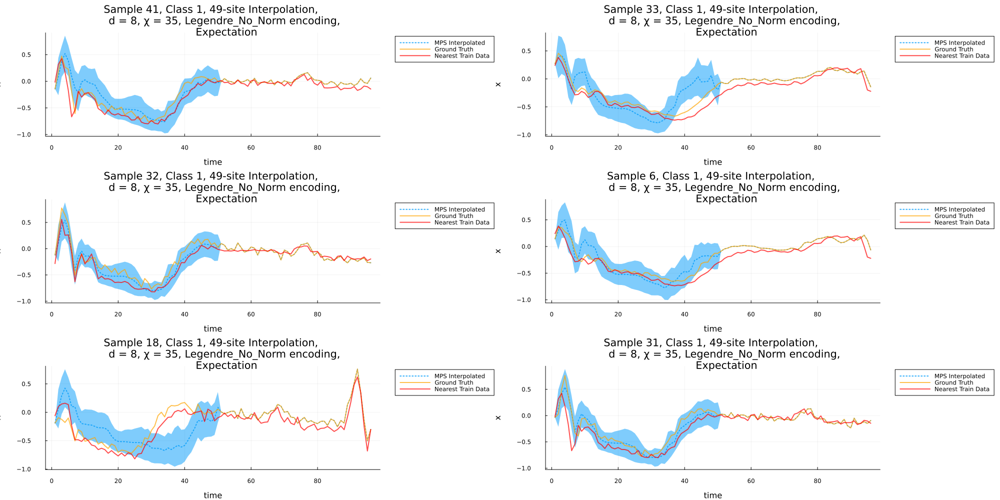

In [8]:

p1 = plot(ps[1:6]..., size=(2000,1000), layout=(3,2))
# savefig(p1, "figs/c0ecg_ns.svg")

p2 = plot(ps[7:12]..., size=(2000,1000), layout=(3,2))
# savefig(p2, "figs/c1ecg_ns.svg")


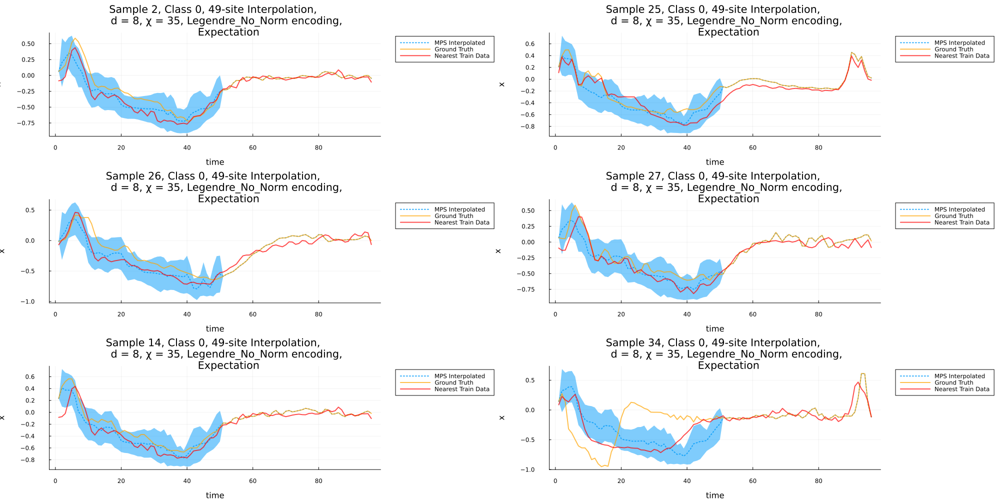

In [9]:
display(p1)

In [27]:
n1s = sum(y_test)
n0s = length(y_test) - n1s


samples = [shuffle(1:n0s); shuffle(1:n1s)]
classes = [zeros(Int,n0s); ones(Int,n1s)]

ps = []
stats = []
MSE_stats = []
for (i,s) in enumerate(samples)
    class = classes[i]
    instance_idx = s
    stat, MSE_stat, p1 = any_interpolate_single_time_series(fc, class, instance_idx, interp_sites, :directMean; MSE_baseline=true, X_train_scaled=X_train_scaled, y_train=y_train);
    push!(ps, p1)
    push!(stats, stat)
    push!(MSE_stats, MSE_stat)
end


╭────────┬──────────╮
│ Metric │    Value │
├────────┼──────────┤
│  SMAPE │  0.99862 │
│    MSE │  0.20102 │
│   MAPE │  1.52557 │
│    MAE │ 0.366935 │
│   RMSE │  0.20102 │
╰────────┴──────────╯
╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │  0.701251 │
│    MSE │ 0.0736518 │
│   MAPE │   1.22362 │
│    MAE │  0.243721 │
│   RMSE │ 0.0736518 │
╰────────┴───────────╯
╭────────┬──────────╮
│ Metric │    Value │
├────────┼──────────┤
│  SMAPE │  1.35899 │
│    MSE │ 0.270678 │
│   MAPE │  4.72817 │
│    MAE │ 0.493406 │
│   RMSE │ 0.270678 │
╰────────┴──────────╯
╭────────┬──────────╮
│ Metric │    Value │
├────────┼──────────┤
│  SMAPE │  1.05407 │
│    MSE │ 0.210579 │
│   MAPE │  4.93712 │
│    MAE │ 0.381864 │
│   RMSE │ 0.210579 │
╰────────┴──────────╯
╭────────┬────────────╮
│ Metric │      Value │
├────────┼────────────┤
│  SMAPE │   0.239024 │
│    MSE │ 0.00972706 │
│   MAPE │   0.272957 │
│    MAE │  0.0788719 │
│   RMSE │ 0.00972706 │
╰──────

In [28]:
stats_df = vcat(DataFrame.(stats)...)
MSE_stats_df = vcat(DataFrame.(MSE_stats)...)

@show describe(stats_df);
println()
@show describe(MSE_stats_df);

describe(stats_df) = 5×7 DataFrame
 Row │ variable  mean      min         median     max        nmissing  eltype
     │ Symbol    Float64   Float64     Float64    Float64    Int64     DataType
─────┼──────────────────────────────────────────────────────────────────────────
   1 │ MAE       0.152404  0.0470851   0.117364    0.498753         0  Float64
   2 │ MAPE      2.48967   0.272957    0.915653   21.0912           0  Float64
   3 │ MSE       0.047883  0.00374177  0.0210581   0.281749         0  Float64
   4 │ RMSE      0.047883  0.00374177  0.0210581   0.281749         0  Float64
   5 │ SMAPE     0.633512  0.183498    0.551447    1.41486          0  Float64

describe(MSE_stats_df) = 5×7 DataFrame
 Row │ variable  mean       min        median     max        nmissing  eltype
     │ Symbol    Float64    Float64    Float64    Float64    Int64     DataType
─────┼──────────────────────────────────────────────────────────────────────────
   1 │ MAE       0.164193   0.0817763  0.142434    0

# Give it less data

In [12]:
n1s = sum(y_test)
n0s = length(y_test) - n1s

n_each = 6
interp_sites = collect(5:96)


samples = [shuffle(1:n0s)[1:n_each]; shuffle(1:n1s)[1:n_each]]
classes = [zeros(Int,n_each); ones(Int,n_each)]

ps = []
stats = []
MSE_stats = []
for (i,s) in enumerate(samples)
    class = classes[i]
    instance_idx = s
    stat, MSE_stat, p1 = any_interpolate_single_time_series(fc, class, instance_idx, interp_sites, :directMean; MSE_baseline=true, X_train_scaled=X_train_scaled, y_train=y_train);
    push!(ps, p1)
    push!(stats, stat)
    push!(MSE_stats, MSE_stat)
end

╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │  0.732796 │
│    MSE │ 0.0077927 │
│   MAPE │   2.67312 │
│    MAE │ 0.0742969 │
│   RMSE │ 0.0077927 │
╰────────┴───────────╯
╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │  0.702003 │
│    MSE │  0.010776 │
│   MAPE │   2.45847 │
│    MAE │ 0.0829649 │
│   RMSE │  0.010776 │
╰────────┴───────────╯
╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │  0.792485 │
│    MSE │ 0.0246416 │
│   MAPE │   0.95136 │
│    MAE │  0.112224 │
│   RMSE │ 0.0246416 │
╰────────┴───────────╯
╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │  0.790962 │
│    MSE │ 0.0108418 │
│   MAPE │   1.05946 │
│    MAE │ 0.0881284 │
│   RMSE │ 0.0108418 │
╰────────┴───────────╯
╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │   1.06511 │
│    MSE │ 0.0829418 │
│   MAPE │   6.07051 │
│    MAE │  0.200039 │
│   RMSE │ 

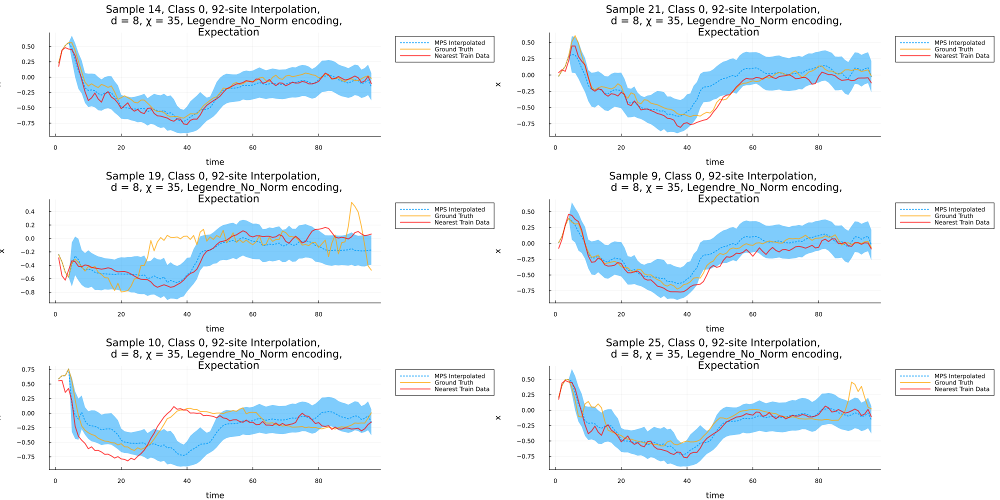

In [13]:
p1 = plot(ps[1:6]..., size=(2000,1000), layout=(3,2))
savefig(p1, "figs/c0ecg_short2.svg")

p2 = plot(ps[7:12]..., size=(2000,1000), layout=(3,2))
savefig(p2, "figs/c1ecg_short2.svg")

display(p1)

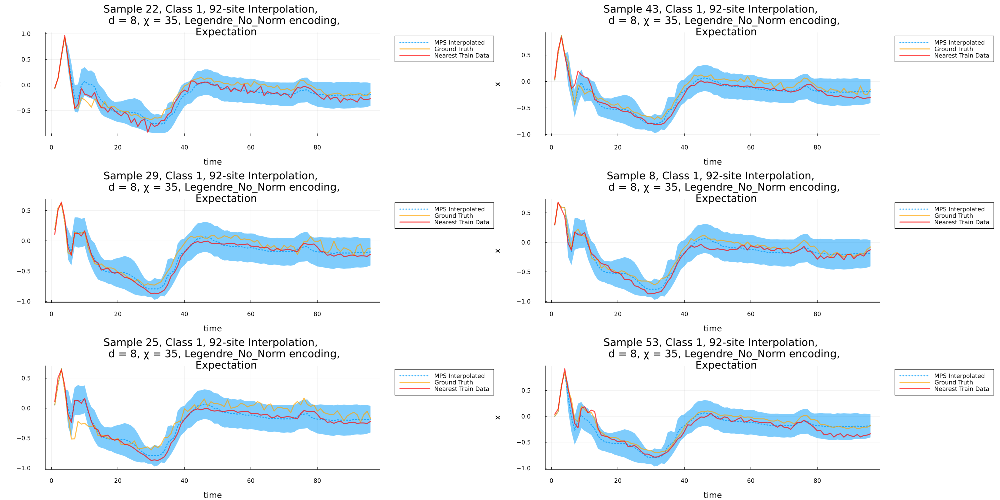

In [14]:
display(p2)

In [16]:
n1s = sum(y_test)
n0s = length(y_test) - n1s


samples = [shuffle(1:n0s); shuffle(1:n1s)]
classes = [zeros(Int,n0s); ones(Int,n1s)]

ps = []
stats = []
MSE_stats = []
for (i,s) in enumerate(samples)
    class = classes[i]
    instance_idx = s
    stat, MSE_stat, p1 = any_interpolate_single_time_series(fc, class, instance_idx, interp_sites, :directMean; MSE_baseline=true, X_train_scaled=X_train_scaled, y_train=y_train);
    push!(ps, p1)
    push!(stats, stat)
    push!(MSE_stats, MSE_stat)
end

╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │  0.732796 │
│    MSE │ 0.0077927 │
│   MAPE │   2.67312 │
│    MAE │ 0.0742969 │
│   RMSE │ 0.0077927 │
╰────────┴───────────╯
╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │  0.702003 │
│    MSE │  0.010776 │
│   MAPE │   2.45847 │
│    MAE │ 0.0829649 │
│   RMSE │  0.010776 │
╰────────┴───────────╯
╭────────┬──────────╮
│ Metric │    Value │
├────────┼──────────┤
│  SMAPE │  1.10596 │
│    MSE │ 0.129771 │
│   MAPE │  5.53238 │
│    MAE │ 0.281997 │
│   RMSE │ 0.129771 │
╰────────┴──────────╯
╭────────┬──────────╮
│ Metric │    Value │
├────────┼──────────┤
│  SMAPE │ 0.840203 │
│    MSE │  0.13565 │
│   MAPE │  5.85099 │
│    MAE │ 0.236127 │
│   RMSE │  0.13565 │
╰────────┴──────────╯
╭────────┬──────────╮
│ Metric │    Value │
├────────┼──────────┤
│  SMAPE │ 0.997124 │
│    MSE │ 0.148374 │
│   MAPE │   6.9914 │
│    MAE │ 0.282557 │
│   RMSE │ 0.148374 │
╰────────┴────

In [17]:
stats_df = vcat(DataFrame.(stats)...)
MSE_stats_df = vcat(DataFrame.(MSE_stats)...)

display(describe(stats_df));
println()
display(describe(MSE_stats_df));

Row,variable,mean,min,median,max,nmissing,eltype
,Symbol,Float64,Float64,Float64,Float64,Int64,DataType
1,MAE,0.136159,0.063777,0.111383,0.284459,0,Float64
2,MAPE,7.62503,0.822994,3.48691,108.87,0,Float64
3,MSE,0.0367088,0.0054951,0.0188371,0.148374,0,Float64
4,RMSE,0.0367088,0.0054951,0.0188371,0.148374,0,Float64
5,SMAPE,0.919083,0.501948,0.896473,1.35405,0,Float64


Row,variable,mean,min,median,max,nmissing,eltype
,Symbol,Float64,Float64,Float64,Float64,Int64,DataType
1,MAE,0.127551,0.0780763,0.107975,0.331852,0,Float64
2,MAPE,4.88759,1.05717,2.99361,57.8,0,Float64
3,MSE,0.0317701,0.00695549,0.0164133,0.185536,0,Float64
4,RMSE,0.0317701,0.00695549,0.0164133,0.185536,0,Float64
5,SMAPE,0.892303,0.571263,0.852193,1.37692,0,Float64


# Middle Only

In [20]:
n1s = sum(y_test)
n0s = length(y_test) - n1s

n_each = 6


samples = [shuffle(1:n0s)[1:n_each]; shuffle(1:n1s)[1:n_each]]
classes = [zeros(Int,n_each); ones(Int,n_each)]
interp_sites = [1:40; 60:96]

ps = []
stats = []
MSE_stats = []
for (i,s) in enumerate(samples)
    class = classes[i]
    instance_idx = s
    stat, MSE_stat, p1 = any_interpolate_single_time_series(fc, class, instance_idx, interp_sites, :directMean; MSE_baseline=true, X_train_scaled=X_train_scaled, y_train=y_train);
    push!(ps, p1)
    push!(stats, stat)
    push!(MSE_stats, MSE_stat)
end

╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │  0.899208 │
│    MSE │ 0.0271512 │
│   MAPE │   4.23042 │
│    MAE │  0.116992 │
│   RMSE │ 0.0271512 │
╰────────┴───────────╯
╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │    1.0221 │
│    MSE │ 0.0345703 │
│   MAPE │   8.63708 │
│    MAE │  0.148333 │
│   RMSE │ 0.0345703 │
╰────────┴───────────╯
╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │   1.01941 │
│    MSE │ 0.0290668 │
│   MAPE │   5.26303 │
│    MAE │  0.148686 │
│   RMSE │ 0.0290668 │
╰────────┴───────────╯
╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │   1.11329 │
│    MSE │ 0.0544465 │
│   MAPE │   5.65169 │
│    MAE │  0.187031 │
│   RMSE │ 0.0544465 │
╰────────┴───────────╯
╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │   1.10832 │
│    MSE │ 0.0298799 │
│   MAPE │   2.71757 │
│    MAE │  0.133595 │
│   RMSE │ 

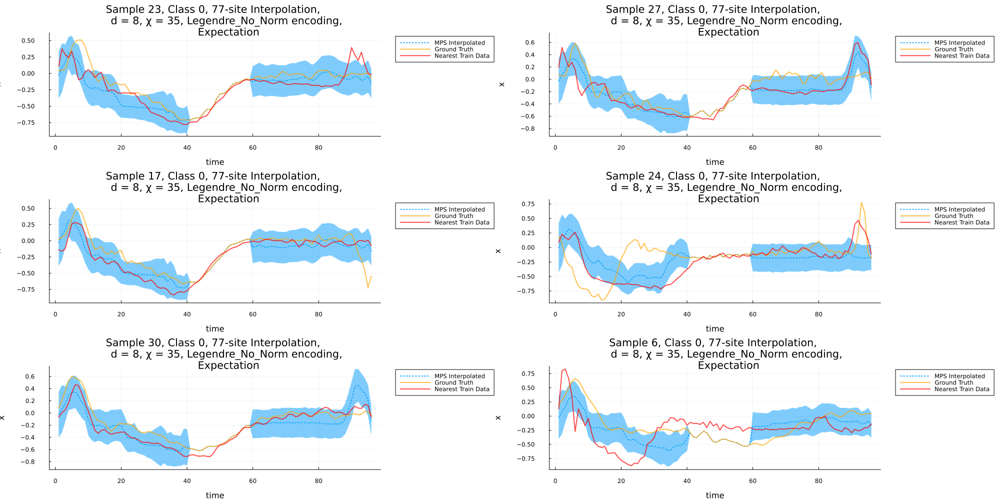

In [21]:
p1 = plot(ps[1:6]..., size=(2000,1000), layout=(3,2))
savefig(p1, "figs/c0ecg_short_mid.svg")

p2 = plot(ps[7:12]..., size=(2000,1000), layout=(3,2))
savefig(p2, "figs/c1ecg_short_mid.svg")

display(p1)

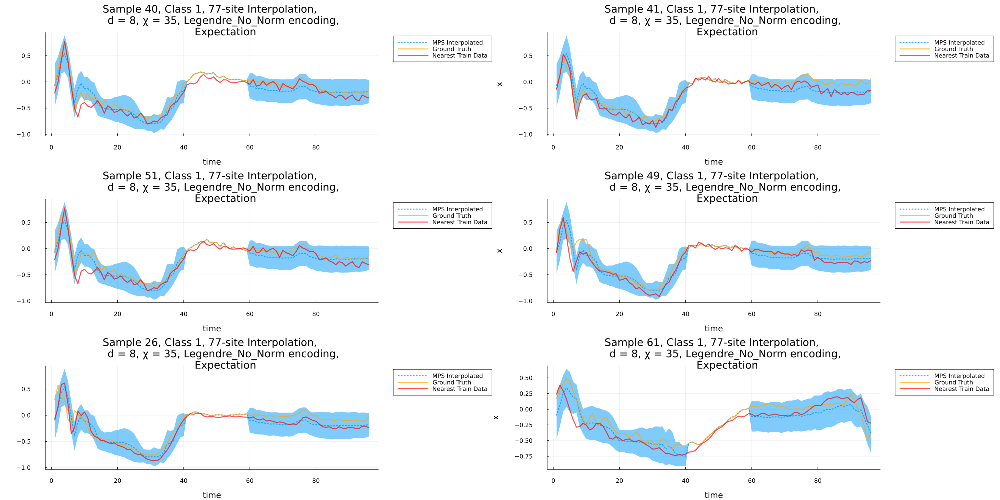

In [22]:
display(p2)

In [23]:
n1s = sum(y_test)
n0s = length(y_test) - n1s


samples = [shuffle(1:n0s); shuffle(1:n1s)]
classes = [zeros(Int,n0s); ones(Int,n1s)]

ps = []
stats = []
MSE_stats = []
for (i,s) in enumerate(samples)
    class = classes[i]
    instance_idx = s
    stat, MSE_stat, p1 = any_interpolate_single_time_series(fc, class, instance_idx, interp_sites, :directMean; MSE_baseline=true, X_train_scaled=X_train_scaled, y_train=y_train);
    push!(ps, p1)
    push!(stats, stat)
    push!(MSE_stats, MSE_stat)
end

╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │   0.94805 │
│    MSE │ 0.0332409 │
│   MAPE │   4.83314 │
│    MAE │  0.156196 │
│   RMSE │ 0.0332409 │
╰────────┴───────────╯
╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │  0.865698 │
│    MSE │ 0.0175042 │
│   MAPE │   1.67357 │
│    MAE │  0.109294 │
│   RMSE │ 0.0175042 │
╰────────┴───────────╯
╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │  0.944975 │
│    MSE │ 0.0395156 │
│   MAPE │   4.66611 │
│    MAE │  0.163058 │
│   RMSE │ 0.0395156 │
╰────────┴───────────╯
╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │   1.02222 │
│    MSE │ 0.0782017 │
│   MAPE │   5.44661 │
│    MAE │  0.202396 │
│   RMSE │ 0.0782017 │
╰────────┴───────────╯
╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │   1.00476 │
│    MSE │ 0.0195087 │
│   MAPE │   7.70665 │
│    MAE │  0.110549 │
│   RMSE │ 

In [24]:
stats_df = vcat(DataFrame.(stats)...)
MSE_stats_df = vcat(DataFrame.(MSE_stats)...)

display(describe(stats_df));
println()
display(describe(MSE_stats_df));

Row,variable,mean,min,median,max,nmissing,eltype
,Symbol,Float64,Float64,Float64,Float64,Int64,DataType
1,MAE,0.132861,0.0672353,0.116243,0.294302,0,Float64
2,MAPE,5.64031,0.43646,2.74544,101.506,0,Float64
3,MSE,0.034951,0.00646609,0.0208516,0.150905,0,Float64
4,RMSE,0.034951,0.00646609,0.0208516,0.150905,0,Float64
5,SMAPE,0.796036,0.425471,0.800509,1.24524,0,Float64


Row,variable,mean,min,median,max,nmissing,eltype
,Symbol,Float64,Float64,Float64,Float64,Int64,DataType
1,MAE,0.147147,0.0824577,0.122895,0.33405,0,Float64
2,MAPE,4.47847,0.435908,2.30134,70.8605,0,Float64
3,MSE,0.0460706,0.0104303,0.0264249,0.230913,0,Float64
4,RMSE,0.0460706,0.0104303,0.0264249,0.230913,0,Float64
5,SMAPE,0.808374,0.429024,0.760248,1.22525,0,Float64


# IPD

In [22]:
svpath = "../../Data/italypower/mps_saves/legendreNN2_d12_chi60.jld2"
f = jldopen(svpath, "r")
    X_train_scaled = read(f, "X_train_scaled")
    y_train = read(f, "y_train")
    X_test_scaled = read(f, "X_test_scaled")
    y_test = read(f, "y_test");
    mps = read(f, "mps")
    opts = read(f, "opts")
close(f)

fc = load_forecasting_info_variables(mps, X_train_scaled, y_train, X_test_scaled, y_test, opts);

++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
                         Summary:

 - Dataset has 67 training samples and 1029 testing samples.
 - 2 class(es) was detected. Slicing MPS into individual states...
 - Time independent encoding - Legendre_No_Norm - detected.
 - d = 12, chi_max = 60

 Created 2 forecastable struct(s) containing class-wise mps and test samples.


╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │  0.470368 │
│    MSE │ 0.0236728 │
│   MAPE │   1.78791 │
│    MAE │  0.107546 │
│   RMSE │ 0.0236728 │
╰────────┴───────────╯
╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │  0.745883 │
│    MSE │ 0.0404108 │
│   MAPE │   2.21733 │
│    MAE │  0.145275 │
│   RMSE │ 0.0404108 │
╰────────┴───────────╯


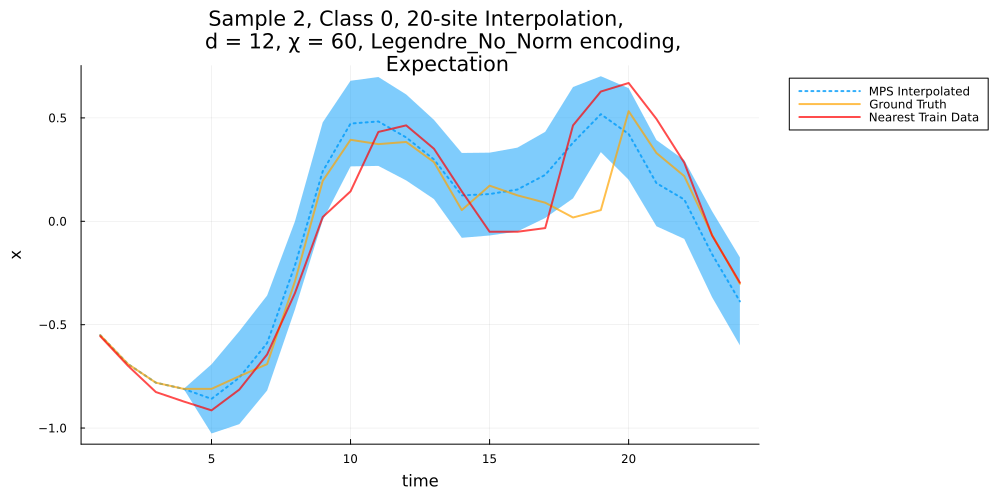

In [24]:
class = 0
interp_sites = collect(5:24)
instance_idx = 2
stats, mse_stats, p1 = any_interpolate_single_time_series(fc, class, instance_idx, interp_sites, :directMean; MSE_baseline=true, X_train_scaled=X_train_scaled, y_train=y_train);

plot(p1)

In [25]:
n1s = sum(y_test)
n0s = length(y_test) - n1s
interp_sites = collect(5:24)


n_each = 6


samples = [shuffle(1:n0s)[1:n_each]; shuffle(1:n1s)[1:n_each]]
classes = [zeros(Int,n_each); ones(Int,n_each)]

ps = []
stats = []
MSE_stats = []
for (i,s) in enumerate(samples)
    class = classes[i]
    instance_idx = s
    stat, MSE_stat, p1 = any_interpolate_single_time_series(fc, class, instance_idx, interp_sites, :directMean; MSE_baseline=true, X_train_scaled=X_train_scaled, y_train=y_train);
    push!(ps, p1)
    push!(stats, stat)
    push!(MSE_stats, MSE_stat)
end



╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │  0.665499 │
│    MSE │ 0.0348619 │
│   MAPE │  0.716438 │
│    MAE │  0.126748 │
│   RMSE │ 0.0348619 │
╰────────┴───────────╯
╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │  0.777939 │
│    MSE │ 0.0733134 │
│   MAPE │   1.28766 │
│    MAE │  0.206247 │
│   RMSE │ 0.0733134 │
╰────────┴───────────╯
╭────────┬──────────╮
│ Metric │    Value │
├────────┼──────────┤
│  SMAPE │ 0.955539 │
│    MSE │ 0.068678 │
│   MAPE │  1.40844 │
│    MAE │  0.21481 │
│   RMSE │ 0.068678 │
╰────────┴──────────╯
╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │  0.812743 │
│    MSE │ 0.0516446 │
│   MAPE │    1.4797 │
│    MAE │  0.174712 │
│   RMSE │ 0.0516446 │
╰────────┴───────────╯
╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │  0.302356 │
│    MSE │ 0.0113188 │
│   MAPE │  0.275549 │
│    MAE │ 0.0868501 │
│   RMSE │ 0.0113188

In [26]:
p1 = plot(ps[1:6]..., size=(2000,1000), layout=(3,2))
savefig(p1, "figs/c0IPD.svg")

p2 = plot(ps[7:12]..., size=(2000,1000), layout=(3,2))
savefig(p2, "figs/c1IPD.svg")

"/home/noodles/Documents/QML Project/QuantumInspiredML/Interpolation/Interp_benchmarks/figs/c1IPD.svg"

p1 = Plot{Plots.GRBackend() n=18}


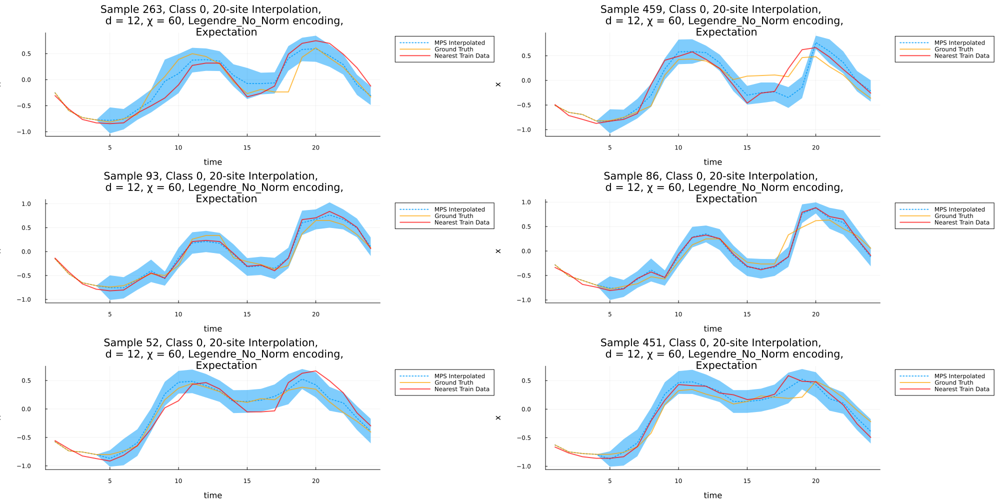

In [27]:
@show p1

In [28]:
n1s = sum(y_test)
n0s = length(y_test) - n1s


samples = [shuffle(1:n0s); shuffle(1:n1s)]
classes = [zeros(Int,n0s); ones(Int,n1s)]

ps = []
stats = []
MSE_stats = []
for (i,s) in enumerate(samples)
    class = classes[i]
    instance_idx = s
    stat, MSE_stat, p1 = any_interpolate_single_time_series(fc, class, instance_idx, interp_sites, :directMean; MSE_baseline=true, X_train_scaled=X_train_scaled, y_train=y_train);
    push!(ps, p1)
    push!(stats, stat)
    push!(MSE_stats, MSE_stat)
end


╭────────┬────────────╮
│ Metric │      Value │
├────────┼────────────┤
│  SMAPE │   0.290334 │
│    MSE │ 0.00579366 │
│   MAPE │   0.407749 │
│    MAE │  0.0620298 │
│   RMSE │ 0.00579366 │
╰────────┴────────────╯
╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │  0.806816 │
│    MSE │ 0.0418722 │
│   MAPE │   1.15642 │
│    MAE │  0.169302 │
│   RMSE │ 0.0418722 │
╰────────┴───────────╯
╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │  0.317963 │
│    MSE │ 0.0290589 │
│   MAPE │   1.11662 │
│    MAE │ 0.0957543 │
│   RMSE │ 0.0290589 │
╰────────┴───────────╯
╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │  0.317751 │
│    MSE │ 0.0294419 │
│   MAPE │   1.09383 │
│    MAE │  0.103653 │
│   RMSE │ 0.0294419 │
╰────────┴───────────╯
╭────────┬───────────╮
│ Metric │     Value │
├────────┼───────────┤
│  SMAPE │  0.304197 │
│    MSE │ 0.0106323 │
│   MAPE │  0.524839 │
│    MAE │ 0.0682117 │
│ 

Excessive output truncated after 524610 bytes.

In [29]:
stats_df = vcat(DataFrame.(stats)...)
MSE_stats_df = vcat(DataFrame.(MSE_stats)...)

display(describe(stats_df));
println()
display(describe(MSE_stats_df));

Row,variable,mean,min,median,max,nmissing,eltype
,Symbol,Float64,Float64,Float64,Float64,Int64,DataType
1,MAE,0.122969,0.0488828,0.103652,0.586332,0,Float64
2,MAPE,4.26621,0.226335,0.95224,1120.97,0,Float64
3,MSE,0.0339287,0.00344693,0.0195599,0.440471,0,Float64
4,RMSE,0.0339287,0.00344693,0.0195599,0.440471,0,Float64
5,SMAPE,0.543504,0.187882,0.493139,1.54378,0,Float64


Row,variable,mean,min,median,max,nmissing,eltype
,Symbol,Float64,Float64,Float64,Float64,Int64,DataType
1,MAE,0.150932,0.0659952,0.144048,0.491815,0,Float64
2,MAPE,4.78765,0.239227,1.16368,1492.29,0,Float64
3,MSE,0.043134,0.0067454,0.0321915,0.398955,0,Float64
4,RMSE,0.043134,0.0067454,0.0321915,0.398955,0,Float64
5,SMAPE,0.661031,0.230929,0.678752,1.32152,0,Float64


# Kepler

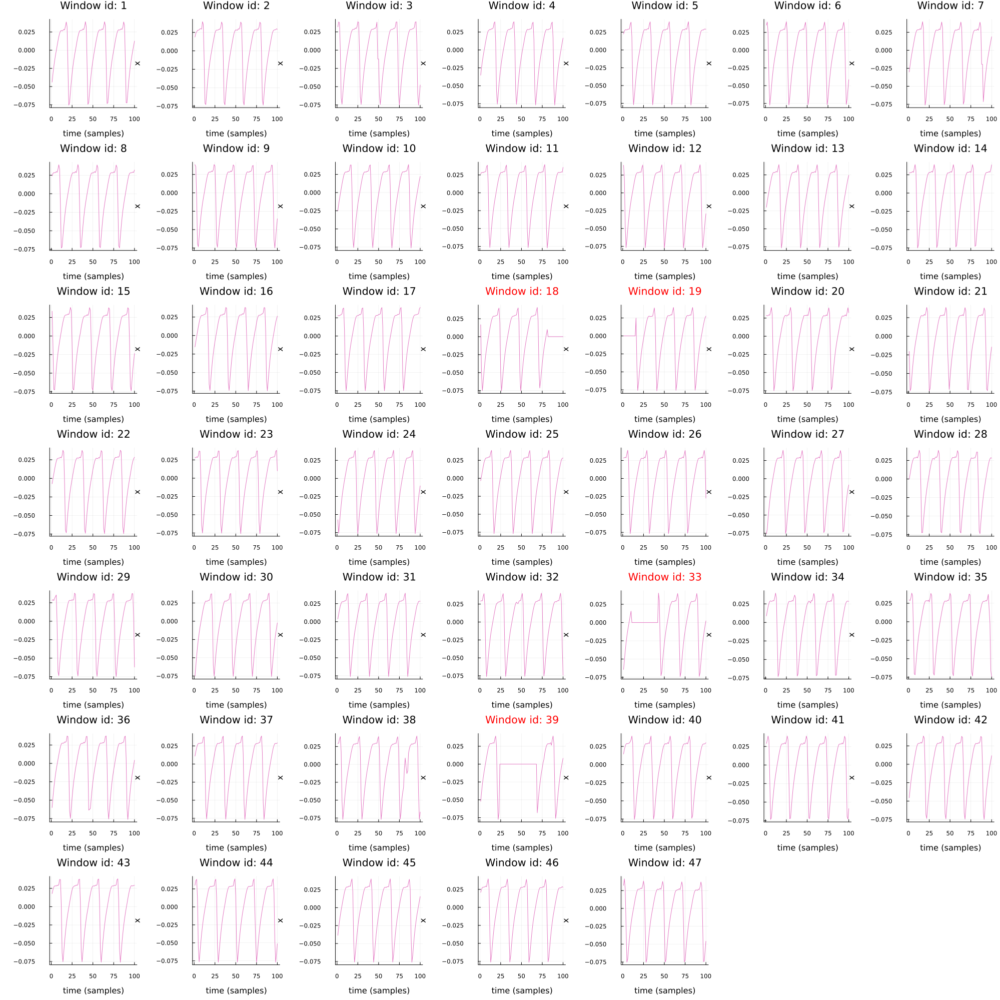

In [33]:
include("../../Data/NASA_kepler/KeplerDataProcessor.jl")
all_kepler = load_dataset("../../Data/NASA_kepler/datasets/KeplerLightCurves.jld2"); 
w = 100
overlap_fraction = 0.0
window_single_instance(all_kepler, 125, w, overlap_fraction);

In [34]:
discard = [18, 19, 33, 39] ####WHAT#### ?? THe same as 1212
X_train, X_test, y_train, y_test = make_train_test_split_singleTS(all_kepler, 125, discard, overlap_fraction; train_fraction=0.85, return_corrupted_windows=true);

MethodError: MethodError: no method matching make_train_test_split_singleTS(::Vector{instance}, ::Int64, ::Vector{Int64}, ::Float64; train_fraction::Float64, return_corrupted_windows::Bool)

Closest candidates are:
  make_train_test_split_singleTS(::Vector{instance}, ::Int64, !Matched::Int64, !Matched::Vector{Int64}, !Matched::Float64; train_fraction, return_corrupted_windows)
   @ Main ~/Documents/QML Project/QuantumInspiredML/Interpolation/paper/NASA_kepler/KeplerDataProcessor.jl:178
  make_train_test_split_singleTS(::Vector{instance}, ::Int64, !Matched::Int64, !Matched::Vector{Int64}; ...)
   @ Main ~/Documents/QML Project/QuantumInspiredML/Interpolation/paper/NASA_kepler/KeplerDataProcessor.jl:178


In [36]:
svpath = "../../Data/NASA_kepler/mps_saves/legendreNN2_d12_chi35.jld2"
f = jldopen(svpath, "r")
    X_train_scaled = read(f, "X_train_scaled")
    y_train = read(f, "y_train")
    X_test_scaled = read(f, "X_test_scaled")
    y_test = read(f, "y_test");
    mps = read(f, "mps")
    opts = read(f, "opts")
close(f)

fc = load_forecasting_info_variables(mps, X_train_scaled, y_train, X_test_scaled, y_test, opts);

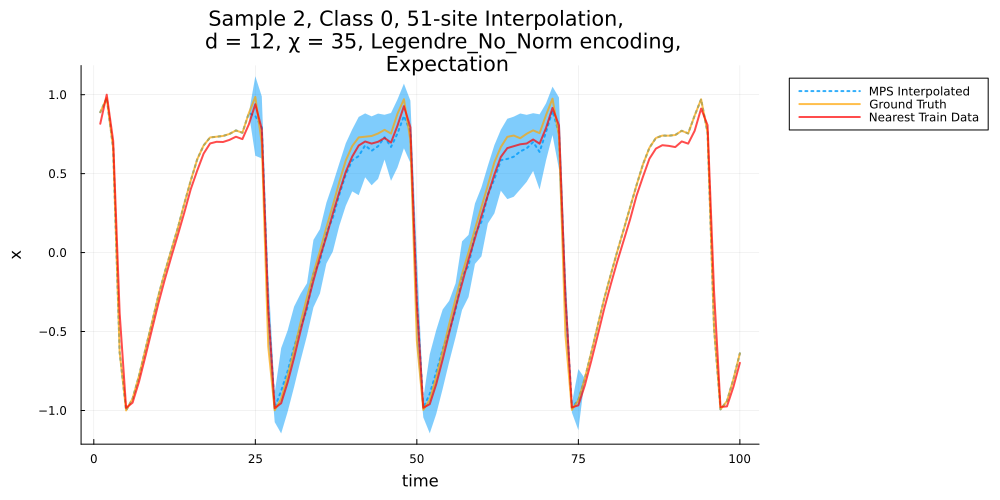

In [37]:
class = 0
interp_sites = collect(25:75)
instance_idx = 2
stats, mse_stats, p1 = any_interpolate_single_time_series(fc, class, instance_idx, interp_sites, :directMean; MSE_baseline=true, X_train_scaled=X_train_scaled, y_train=y_train);

plot(p1)

In [38]:
ns = length(y_test) 
interp_sites = collect(25:75)


samples = 1:ns
classes = zeros(Int,ns)

ps = []
stats = []
MSE_stats = []
for (i,s) in enumerate(samples)
    class = classes[i]
    instance_idx = s
    stat, MSE_stat, p1 = any_interpolate_single_time_series(fc, class, instance_idx, interp_sites, :directMean; MSE_baseline=true, X_train_scaled=X_train_scaled, y_train=y_train);
    push!(ps, p1)
    push!(stats, stat)
    push!(MSE_stats, MSE_stat)
end

In [39]:
stats_df = vcat(DataFrame.(stats)...)
MSE_stats_df = vcat(DataFrame.(MSE_stats)...)

display(describe(stats_df));
println()
display(describe(MSE_stats_df));

Row,variable,mean,min,median,max,nmissing,eltype
,Symbol,Float64,Float64,Float64,Float64,Int64,DataType
1,MAE,0.17232,0.0463792,0.0997785,0.472462,0,Float64
2,MAPE,1.45106,0.13008,0.85657,4.93423,0,Float64
3,MSE,0.0866784,0.005173,0.0305666,0.311606,0,Float64
4,RMSE,0.0866784,0.005173,0.0305666,0.311606,0,Float64
5,SMAPE,0.466476,0.124126,0.329849,1.32323,0,Float64


Row,variable,mean,min,median,max,nmissing,eltype
,Symbol,Float64,Float64,Float64,Float64,Int64,DataType
1,MAE,0.147882,0.0389496,0.100454,0.481143,0,Float64
2,MAPE,1.0792,0.12194,0.609613,4.75027,0,Float64
3,MSE,0.0682483,0.00389602,0.0316879,0.329128,0,Float64
4,RMSE,0.0682483,0.00389602,0.0316879,0.329128,0,Float64
5,SMAPE,0.441887,0.122898,0.328108,1.35596,0,Float64


In [40]:
stats_df_tr = vcat(DataFrame.(stats[1:7])...)
MSE_stats_df_tr = vcat(DataFrame.(MSE_stats[1:7])...)

display(describe(stats_df_tr));
println()
display(describe(MSE_stats_df_tr));

Row,variable,mean,min,median,max,nmissing,eltype
,Symbol,Float64,Float64,Float64,Float64,Int64,DataType
1,MAE,0.128304,0.0463792,0.0972248,0.245974,0,Float64
2,MAPE,1.17405,0.13008,0.85657,3.88728,0,Float64
3,MSE,0.0592414,0.005173,0.030184,0.173318,0,Float64
4,RMSE,0.0592414,0.005173,0.030184,0.173318,0,Float64
5,SMAPE,0.350586,0.124126,0.288365,0.630629,0,Float64


Row,variable,mean,min,median,max,nmissing,eltype
,Symbol,Float64,Float64,Float64,Float64,Int64,DataType
1,MAE,0.0921008,0.0389496,0.0879119,0.178125,0,Float64
2,MAPE,0.650501,0.12194,0.609613,1.72012,0,Float64
3,MSE,0.0312455,0.00389602,0.0241424,0.0919787,0,Float64
4,RMSE,0.0312455,0.00389602,0.0241424,0.0919787,0,Float64
5,SMAPE,0.282526,0.122898,0.278599,0.525347,0,Float64


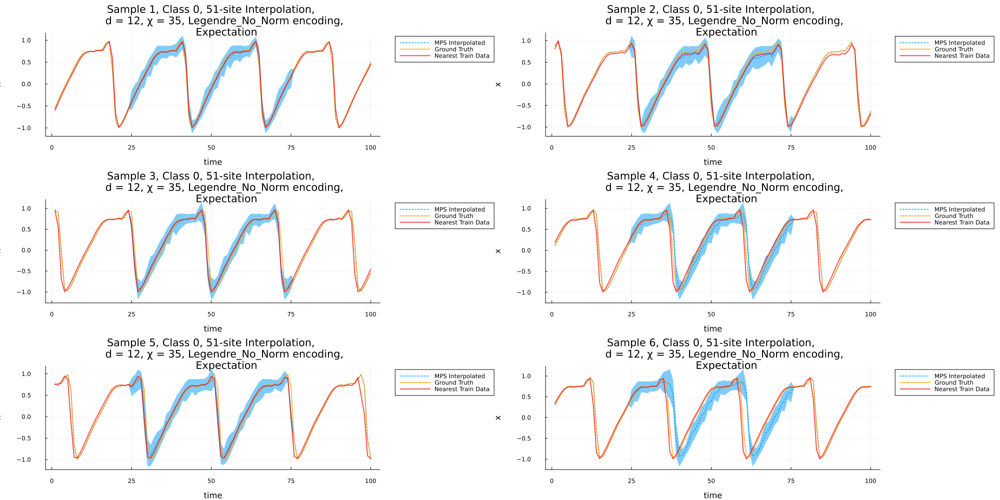

In [42]:
p1 = plot(ps[1:6]..., size=(2000,1000), layout=(3,2))
savefig(p1, "figs/Keps125_1.svg")

p2 = plot(ps[7:11]..., size=(2000,1000), layout=(3,2))
savefig(p2, "figs/Keps125_2.svg")
display(p1)

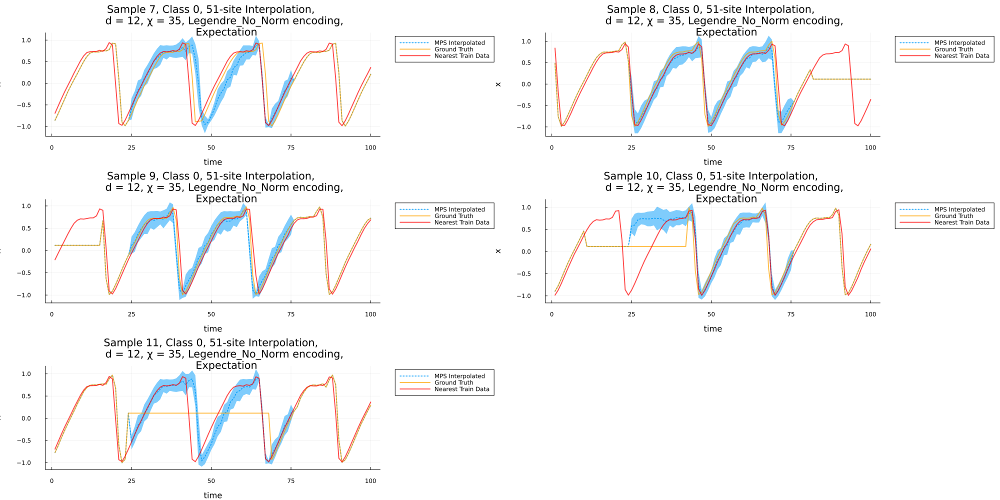

In [43]:
display(p2)

## Direct Mode

In [45]:
ns = length(y_test) 


samples = 1:ns
classes = zeros(Int,ns)

ps = []
stats = []
MSE_stats = []
for (i,s) in enumerate(samples)
    class = classes[i]
    instance_idx = s
    stat, MSE_stat, p1 = any_interpolate_single_time_series(fc, class, instance_idx, interp_sites, :directMode; MSE_baseline=true, X_train_scaled=X_train_scaled, y_train=y_train);
    push!(ps, p1)
    push!(stats, stat)
    push!(MSE_stats, MSE_stat)
end

In [46]:
stats_df = vcat(DataFrame.(stats)...)
MSE_stats_df = vcat(DataFrame.(MSE_stats)...)

display(describe(stats_df));
println()
display(describe(MSE_stats_df));

Row,variable,mean,min,median,max,nmissing,eltype
,Symbol,Float64,Float64,Float64,Float64,Int64,DataType
1,MAE,0.167084,0.0369101,0.0950802,0.531815,0,Float64
2,MAPE,1.21102,0.11776,0.702195,4.883,0,Float64
3,MSE,0.0972973,0.00386375,0.0287664,0.453579,0,Float64
4,RMSE,0.0972973,0.00386375,0.0287664,0.453579,0,Float64
5,SMAPE,0.448309,0.112773,0.280492,1.34618,0,Float64


Row,variable,mean,min,median,max,nmissing,eltype
,Symbol,Float64,Float64,Float64,Float64,Int64,DataType
1,MAE,0.147882,0.0389496,0.100454,0.481143,0,Float64
2,MAPE,1.0792,0.12194,0.609613,4.75027,0,Float64
3,MSE,0.0682483,0.00389602,0.0316879,0.329128,0,Float64
4,RMSE,0.0682483,0.00389602,0.0316879,0.329128,0,Float64
5,SMAPE,0.441887,0.122898,0.328108,1.35596,0,Float64


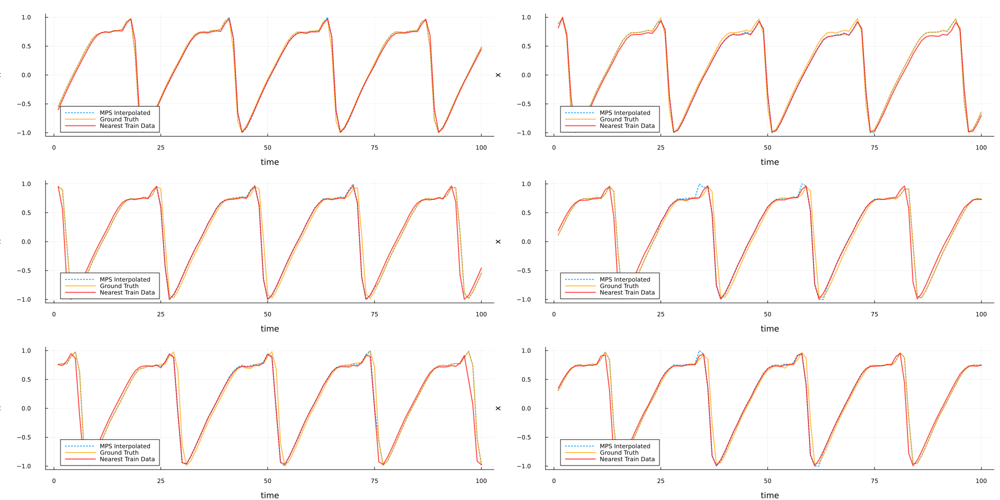

In [47]:
p1 = plot(ps[1:6]..., size=(2000,1000), layout=(3,2))
savefig(p1, "figs/Keps125_1_mode.svg")

p2 = plot(ps[7:11]..., size=(2000,1000), layout=(3,2))
savefig(p2, "figs/Keps125_2_mode.svg")
display(p1)

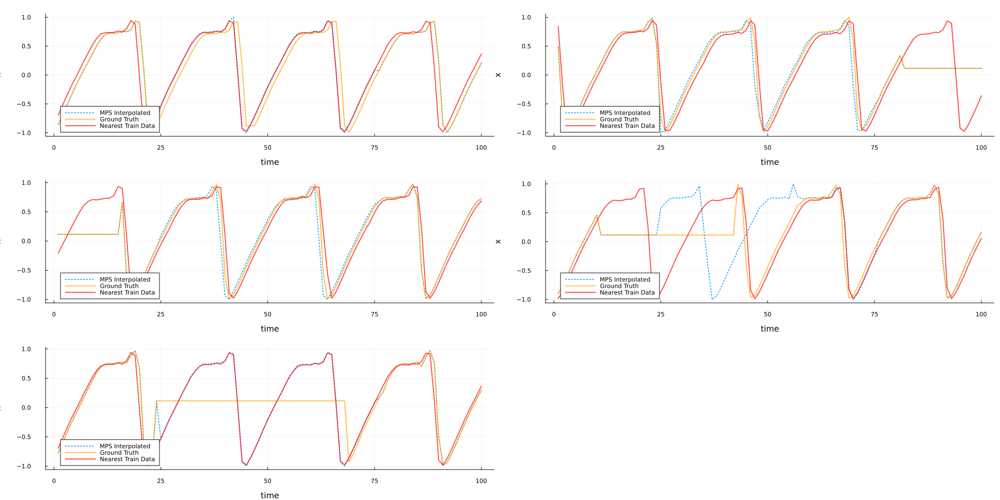

In [49]:
display(p2)

# Rand Kepler

In [3]:
svpath = "../../Data/NASA_kepler/mps_saves/legendreNN2_d12_chi35.jld2"
f = jldopen(svpath, "r")
    X_train_scaled = read(f, "X_train_scaled")
    y_train = read(f, "y_train")
    X_test_scaled = read(f, "X_test_scaled")
    y_test = read(f, "y_test");
    mps = read(f, "mps")
    opts = read(f, "opts")
close(f)

fc = load_forecasting_info_variables(mps, X_train_scaled, y_train, X_test_scaled, y_test, opts);

++++++++++++++++++++++++++++++++++++++++++++++++++++++++++++
                         Summary:

 - Dataset has 36 training samples and 11 testing samples.
 - 1 class(es) was detected. Slicing MPS into individual states...
 - Time independent encoding - Legendre_No_Norm - detected.
 - d = 12, chi_max = 35

 Created 1 forecastable struct(s) containing class-wise mps and test samples.


In [20]:
ns = length(y_test) 
interp_sites = shuffle(1:100)[1:90]


samples = 1:ns
classes = zeros(Int,ns)

ps = []
stats = []
MSE_stats = []
for (i,s) in enumerate(samples)
    class = classes[i]
    instance_idx = s
    stat, MSE_stat, p1 = any_interpolate_single_time_series(fc, class, instance_idx, interp_sites, :directMean; MSE_baseline=true, X_train_scaled=X_train_scaled, y_train=y_train);
    push!(ps, p1)
    push!(stats, stat)
    push!(MSE_stats, MSE_stat)
end

╭────────┬──────────╮
│ Metric │    Value │
├────────┼──────────┤
│  SMAPE │  1.19243 │
│    MSE │  0.63882 │
│   MAPE │  1.85313 │
│    MAE │ 0.618313 │
│   RMSE │  0.63882 │
╰────────┴──────────╯
╭────────┬────────────╮
│ Metric │      Value │
├────────┼────────────┤
│  SMAPE │     0.1205 │
│    MSE │ 0.00395745 │
│   MAPE │    0.12078 │
│    MAE │  0.0402488 │
│   RMSE │ 0.00395745 │
╰────────┴────────────╯
╭────────┬──────────╮
│ Metric │    Value │
├────────┼──────────┤
│  SMAPE │  1.20328 │
│    MSE │ 0.744004 │
│   MAPE │  7.87114 │
│    MAE │ 0.659282 │
│   RMSE │ 0.744004 │
╰────────┴──────────╯
╭────────┬────────────╮
│ Metric │      Value │
├────────┼────────────┤
│  SMAPE │   0.230541 │
│    MSE │ 0.00621347 │
│   MAPE │   0.626005 │
│    MAE │  0.0642983 │
│   RMSE │ 0.00621347 │
╰────────┴────────────╯
╭────────┬──────────╮
│ Metric │    Value │
├────────┼──────────┤
│  SMAPE │  1.30072 │
│    MSE │ 0.776573 │
│   MAPE │  3.27664 │
│    MAE │ 0.698148 │
│   RMSE │ 0.77657

In [21]:
stats_df = vcat(DataFrame.(stats)...)
MSE_stats_df = vcat(DataFrame.(MSE_stats)...)

display(describe(stats_df));
println()
display(describe(MSE_stats_df));

Row,variable,mean,min,median,max,nmissing,eltype
,Symbol,Float64,Float64,Float64,Float64,Int64,DataType
1,MAE,0.637831,0.557838,0.637594,0.698148,0,Float64
2,MAPE,2.97087,1.69164,2.49354,7.87114,0,Float64
3,MSE,0.667172,0.514554,0.658653,0.776573,0,Float64
4,RMSE,0.667172,0.514554,0.658653,0.776573,0,Float64
5,SMAPE,1.23802,1.10605,1.25857,1.38537,0,Float64


Row,variable,mean,min,median,max,nmissing,eltype
,Symbol,Float64,Float64,Float64,Float64,Int64,DataType
1,MAE,0.161085,0.0402488,0.121252,0.401127,0,Float64
2,MAPE,1.00633,0.12078,0.626005,2.70886,0,Float64
3,MSE,0.0816689,0.00395745,0.0362583,0.273417,0,Float64
4,RMSE,0.0816689,0.00395745,0.0362583,0.273417,0,Float64
5,SMAPE,0.458005,0.1205,0.36444,1.06668,0,Float64


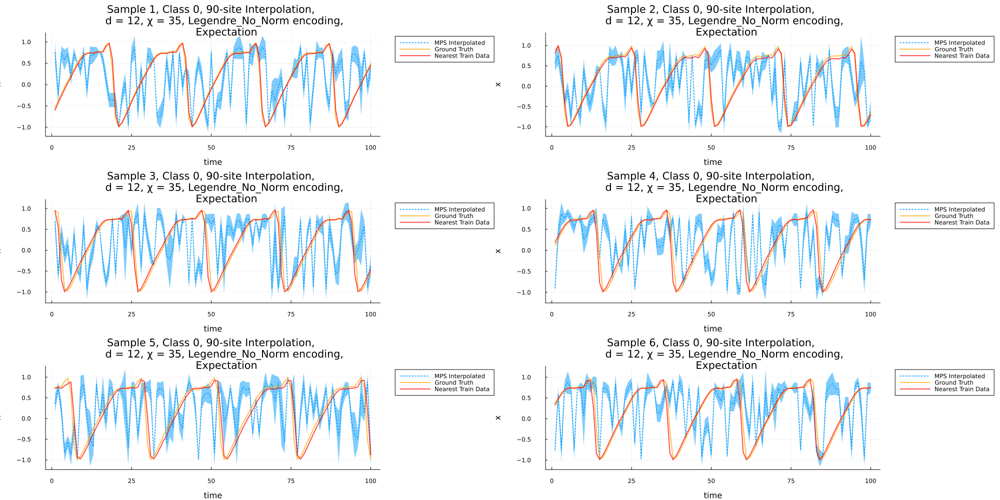

In [22]:
p1 = plot(ps[1:6]..., size=(2000,1000), layout=(3,2))
savefig(p1, "figs/Keps125_1_rand.svg")

p2 = plot(ps[7:11]..., size=(2000,1000), layout=(3,2))
savefig(p2, "figs/Keps125_2_rand.svg")
display(p1)

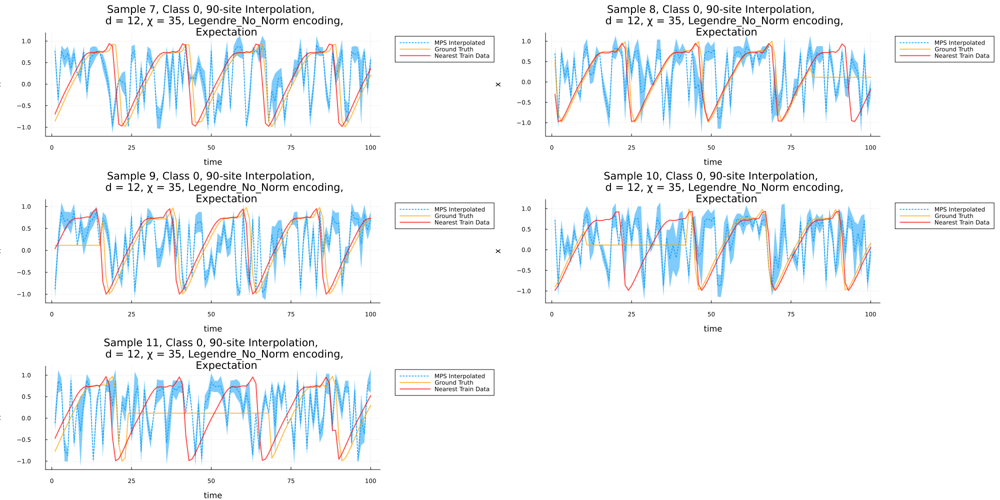

In [23]:
display(p2)

# Kepler 564

In [53]:

f = jldopen("../../Data/NASA_kepler/mps_saves/legendreNN_s564_d12_chi34.jld2")
X_train_scaled = read(f, "X_train_scaled")
y_train = read(f, "y_train")
X_test_scaled = read(f, "X_test_scaled")
y_test = read(f, "y_test");
mps = read(f, "mps")
opts = read(f, "opts")
close(f)

fc = load_forecasting_info_variables(mps, X_train_scaled, y_train, X_test_scaled, y_test, opts);

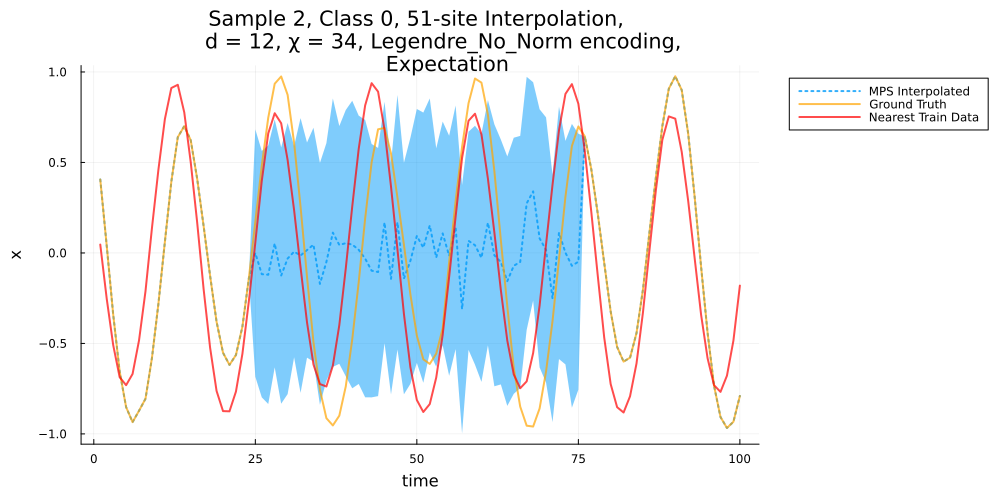

In [54]:
class = 0
interp_sites = collect(25:75)
instance_idx = 2
stats, mse_stats, p1 = any_interpolate_single_time_series(fc, class, instance_idx, interp_sites, :directMean; MSE_baseline=true, X_train_scaled=X_train_scaled, y_train=y_train);

plot(p1)

In [55]:
ns = length(y_test) 


samples = 1:ns
classes = zeros(Int,ns)

ps = []
stats = []
MSE_stats = []
for (i,s) in enumerate(samples)
    class = classes[i]
    instance_idx = s
    stat, MSE_stat, p1 = any_interpolate_single_time_series(fc, class, instance_idx, interp_sites, :directMean; MSE_baseline=true, X_train_scaled=X_train_scaled, y_train=y_train);
    push!(ps, p1)
    push!(stats, stat)
    push!(MSE_stats, MSE_stat)
end

In [56]:
stats_df = vcat(DataFrame.(stats)...)
MSE_stats_df = vcat(DataFrame.(MSE_stats)...)

display(describe(stats_df));
println()
display(describe(MSE_stats_df));

Row,variable,mean,min,median,max,nmissing,eltype
,Symbol,Float64,Float64,Float64,Float64,Int64,DataType
1,MAE,0.217501,0.0574605,0.113854,0.586258,0,Float64
2,MAPE,7.03645,0.288472,1.09401,106.671,0,Float64
3,MSE,0.103051,0.00494075,0.0174776,0.448161,0,Float64
4,RMSE,0.103051,0.00494075,0.0174776,0.448161,0,Float64
5,SMAPE,0.69571,0.222376,0.394725,1.80708,0,Float64


Row,variable,mean,min,median,max,nmissing,eltype
,Symbol,Float64,Float64,Float64,Float64,Int64,DataType
1,MAE,0.171684,0.0462833,0.13347,0.517761,0,Float64
2,MAPE,8.60129,0.283754,0.945156,129.724,0,Float64
3,MSE,0.0585071,0.00342999,0.0226979,0.364049,0,Float64
4,RMSE,0.0585071,0.00342999,0.0226979,0.364049,0,Float64
5,SMAPE,0.542485,0.186248,0.471602,1.77636,0,Float64


In [57]:
stats_df_tr = vcat(DataFrame.(stats[1:22])...)
MSE_stats_df_tr = vcat(DataFrame.(MSE_stats[1:22])...)

display(describe(stats_df_tr));
println()
display(describe(MSE_stats_df_tr));

Row,variable,mean,min,median,max,nmissing,eltype
,Symbol,Float64,Float64,Float64,Float64,Int64,DataType
1,MAE,0.214246,0.0603681,0.113854,0.586258,0,Float64
2,MAPE,1.17775,0.288472,1.09401,3.93098,0,Float64
3,MSE,0.0997244,0.00494075,0.0174776,0.448161,0,Float64
4,RMSE,0.0997244,0.00494075,0.0174776,0.448161,0,Float64
5,SMAPE,0.663585,0.222376,0.394725,1.77815,0,Float64


Row,variable,mean,min,median,max,nmissing,eltype
,Symbol,Float64,Float64,Float64,Float64,Int64,DataType
1,MAE,0.152761,0.0462833,0.12581,0.302063,0,Float64
2,MAPE,1.55125,0.283754,0.945156,12.5557,0,Float64
3,MSE,0.0400591,0.00342999,0.0208365,0.135092,0,Float64
4,RMSE,0.0400591,0.00342999,0.0208365,0.135092,0,Float64
5,SMAPE,0.474702,0.186248,0.432491,0.75644,0,Float64


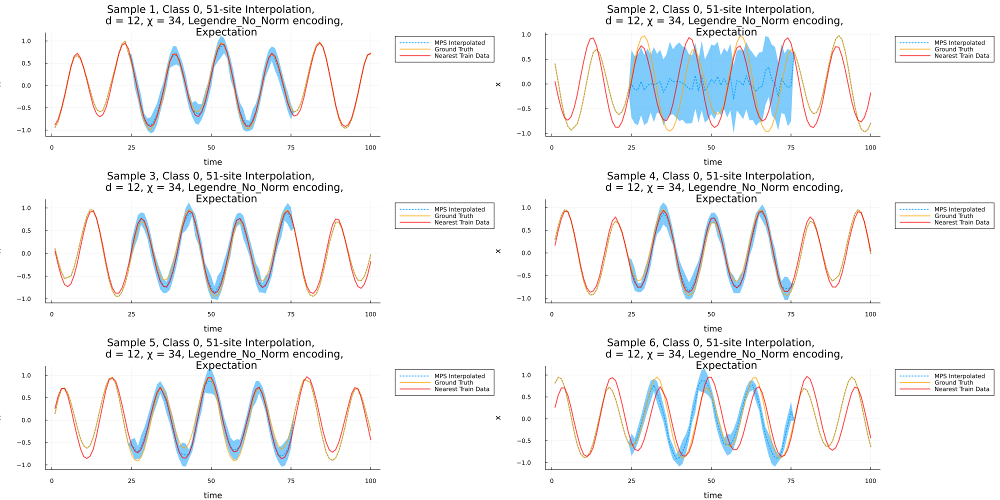

In [58]:
p1 = plot(ps[1:6]..., size=(2000,1000), layout=(3,2))
savefig(p1, "figs/Keps564_1.svg")

p2 = plot(ps[end-5:end]..., size=(2000,1000), layout=(3,2))
savefig(p2, "figs/Keps564_2.svg")
display(p1)

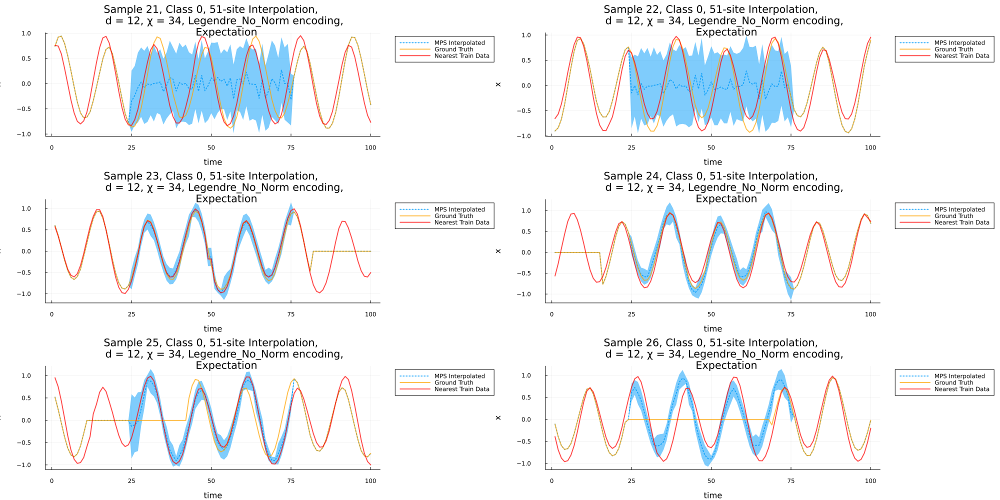

In [59]:
display(p2)